In [1]:
# Activate and install required packages
using Pkg
Pkg.activate(".")
Pkg.add(["Plots", "NCDatasets", "ColorSchemes"])

  Activating project at `~/Desktop/Minor/NEW/PhysicsInformedNN_Alkalinity/notebooks`
   Resolving package versions...
  No Changes to `~/Desktop/Minor/NEW/PhysicsInformedNN_Alkalinity/notebooks/Project.toml`
  No Changes to `~/Desktop/Minor/NEW/PhysicsInformedNN_Alkalinity/notebooks/Manifest.toml`
Precompiling project...
  34730.9 ms  ✓ Plots → UnitfulExt
  1 dependency successfully precompiled in 36 seconds. 204 already precompiled.


In [2]:
# Load packages
using Plots
using NCDatasets
using ColorSchemes
using Printf

[ Info: Precompiling Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80] (cache misses: wrong dep version loaded (2), wrong source (2), dep missing source (2))
[ Info: Precompiling IJuliaExt [2f4121a4-3b3a-5ce6-9c5e-1f2673ce168a] (cache misses: wrong dep version loaded (6))


[ Info: Saved animation to /Users/kavyaagarwal/Desktop/Minor/NEW/PhysicsInformedNN_Alkalinity/notebooks/tracer_animation.gif


Plots.AnimatedGif("/Users/kavyaagarwal/Desktop/Minor/NEW/PhysicsInformedNN_Alkalinity/notebooks/tracer_animation.gif")
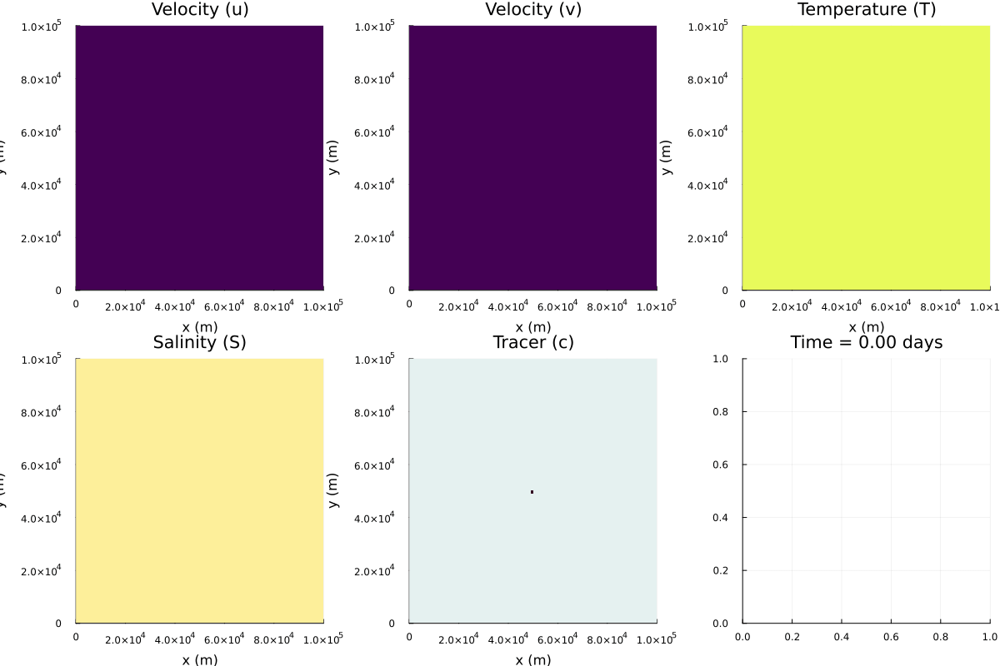

In [4]:
# Open the NetCDF file
#filename = "output_2025-01-26.nc"
filename = "output-tracer-release-gaussian-wind_2025-06-18.nc"
ds = NCDataset(filename)

# Extract coordinates and variables
xC = ds["xC"][:]  # x-coordinates at cell centers (100 points)
yC = ds["yC"][:]  # y-coordinates at cell centers (100 points)
time = ds["time"][:]  # Time steps in seconds (241 steps)

# Create an animation
anim = @animate for time_index in 1:length(time)
    # Extract variables at the current time step
    u = ds["u"][:, :, 1, time_index]  # Velocity in the x-direction (100x100)
    v = ds["v"][:, :, 1, time_index]  # Velocity in the y-direction (100x100)
    T = ds["T"][:, :, 1, time_index]  # Temperature (100x100)
    S = ds["S"][:, :, 1, time_index]  # Salinity (100x100)
    c = ds["c"][:, :, 1, time_index]  # Tracer concentration (100x100)

    # Create a multi-panel plot for the current time step
    plot(layout=(2, 3), size=(1200, 800), legend=false)

    # Plot u (x-velocity)
    heatmap!(xC, yC, u', subplot=1, title="Velocity (u)", xlabel="x (m)", ylabel="y (m)", color=:viridis)

    # Plot v (y-velocity)
    heatmap!(xC, yC, v', subplot=2, title="Velocity (v)", xlabel="x (m)", ylabel="y (m)", color=:viridis)

    # Plot T (Temperature)
    heatmap!(xC, yC, T', subplot=3, title="Temperature (T)", xlabel="x (m)", ylabel="y (m)", color=:thermal)

    # Plot S (Salinity)
    heatmap!(xC, yC, S', subplot=4, title="Salinity (S)", xlabel="x (m)", ylabel="y (m)", color=:haline)

    # Plot c (Tracer concentration)
    heatmap!(xC, yC, c', subplot=5, title="Tracer (c)", xlabel="x (m)", ylabel="y (m)", color=:dense)

    # Add a title with the current time
    time_days = time[time_index] / (24 * 3600)  # Convert seconds to days
    plot!(title="Time = $(@sprintf("%.2f", time_days)) days", subplot=6)
end

# Close the NetCDF file
close(ds)

# Save the animation as a GIF
gif(anim, "tracer_animation.gif", fps=10)